In [49]:
# Cleaning and data manipulation
import pandas as pd
import numpy as np
import datetime

# Data visualization
import seaborn as sns
import matplotlib.pyplot as plt
import folium
from folium.plugins import MarkerCluster
import geopandas as gpd

# Statistic test
import scipy.stats as stats

# Other libraries
import warnings
warnings.filterwarnings("ignore")

In [50]:
airbnb=pd.read_csv('airbnb_cleaned.csv')
airbnb.head()

,id,name,host_id,host_name,neighbourhood,room_type,latitude,longitude,price,minimum_nights,availability_365,calculated_host_listings_count,number_of_reviews,number_of_reviews_ltm,reviews_per_month,last_review,host_response_rate,review_scores_rating,area_category
0,27934,Nice room with superb city view,120437,Nuttee,Ratchathewi,Entire home/apt,13.75983,100.54134,1905,3,353,2,65,0,0.50,2020-01-06,100.0,4.86,Inner City
1,27979,"Easy going landlord,easy place",120541,Emy,Bang Na,Private room,13.66818,100.61674,1316,1,358,2,0,0,0.00,1970-01-01,0.0,0.00,Middle City
2,28745,modern-style apartment in Bangkok,123784,Familyroom,Bang Kapi,Private room,13.75232,100.62402,800,60,365,1,0,0,0.00,1970-01-01,0.0,0.00,Middle City
3,35780,Spacious one bedroom at The Kris Condo Bldg. 3,153730,Sirilak,Din Daeng,Private room,13.78823,100.57256,1286,7,323,1,2,1,0.03,2022-04-01,100.0,4.83,Inner City
4,941865,Suite Room 3 at MetroPoint,610315,Kasem,Bang Kapi,Private room,13.76872,100.63338,1905,1,365,3,0,0,0.00,1970-01-01,100.0,4.00,Middle City


In [51]:
airbnb["last_review"] = pd.to_datetime(airbnb["last_review"], errors="coerce")

print(airbnb.dtypes)

id                                         int64
name                                      object
host_id                                    int64
host_name                                 object
neighbourhood                             object
room_type                                 object
latitude                                 float64
longitude                                float64
price                                      int64
minimum_nights                             int64
availability_365                           int64
calculated_host_listings_count             int64
number_of_reviews                          int64
number_of_reviews_ltm                      int64
reviews_per_month                        float64
last_review                       datetime64[ns]
host_response_rate                       float64
review_scores_rating                     float64
area_category                             object
dtype: object


### **Pernyataan Masalah**

1. **Perbedaan Rating Antar Wilayah**: Bagaimana Karakteristik Properti dan Performa Host Menjelaskan Variasi Rating di Berbagai Wilayah Bangkok, Khususnya Selama Krisis COVID-19?

2. **Perubahan Preferensi Lokasi Tamu**: Bagaimana Pandemi COVID-19 Mempengaruhi Pilihan Tamu terhadap Properti?

3. **Perubahan Pola Musiman:** Bagaimana Pola Musiman Mempengaruhi Strategi Pemasaran Properti Airbnb di Bangkok Sebelum dan Setelah Pandemi COVID-19?

## **Exploratory Data Analysis (EDA)**

Sebelum memulai analisis, marilah kita memahami pola data terlebih dahulu

### **1. Distribusi Geografis & Rating**

**Peta sebaran properti di Bangkok `review_scores_rating` menggunakan `latitude` dan `longitude`**

In [55]:
map_bangkok = folium.Map(location=[13.7563, 100.5018], zoom_start=11, tiles='CartoDB positron')

# sampled_data = airbnb.sample(5000, random_state=42)

marker_cluster = MarkerCluster().add_to(map_bangkok)

for _, row in airbnb.iterrows():
    folium.CircleMarker(
        location=[row['latitude'], row['longitude']],
        radius=5,
        color='green' if row['review_scores_rating'] >= 4.5 else 'yellow' if row['review_scores_rating'] >= 3.0 else 'red',
        fill=True,
        fill_opacity=0.7,
        popup=f"Price: {row['price']}<br>Rating: {row['review_scores_rating']}"
    ).add_to(marker_cluster)

map_bangkok

**Area pusat kota (inner city) didominasi oleh properti dengan rating menengah ke rendah (warna kuning dan merah),** Hal ini mungkin menunjukkan bahwa ekspektasi tamu di pusat kota lebih tinggi dibanding area pinggiran

**Box plot sebaran `review_scores_rating` berdasarkan `neighbourhood`**

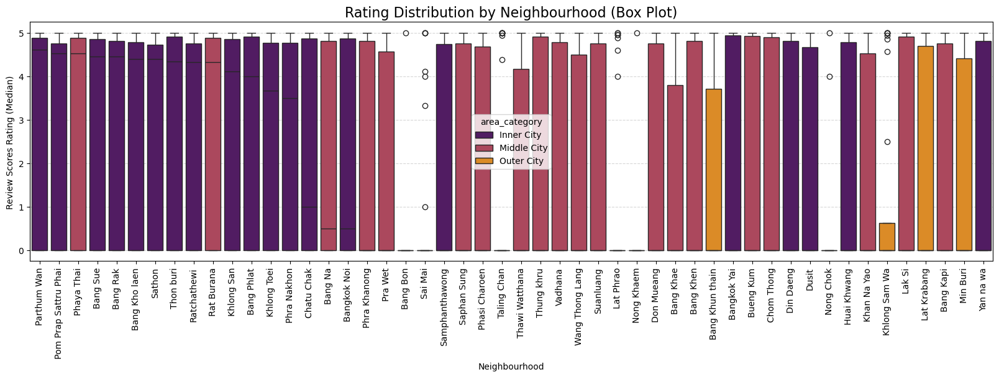

In [58]:
airbnb_rating_by_neighbourhood = airbnb.groupby('neighbourhood')['review_scores_rating'].median().sort_values(ascending=False)

plt.figure(figsize=(20, 5))
sns.boxplot(data=airbnb,
            x='neighbourhood',
            y='review_scores_rating',
            palette='inferno',
            hue='area_category',
            order=airbnb_rating_by_neighbourhood.index.get_level_values(0).unique())

plt.xticks(rotation=90)
plt.title('Rating Distribution by Neighbourhood (Box Plot)', fontsize=16)
plt.ylabel('Review Scores Rating (Median)')
plt.xlabel('Neighbourhood')
plt.grid(True, axis='y', linestyle='--', alpha=0.5)
plt.show()

**Beberapa neighbourhood menunjukkan konsistensi rating yang tinggi dengan variasi kecil,** sementara lainnya memiliki variasi rating yang lebih besar, disertai outlier yang mengindikasikan properti dengan rating sangat rendah.

**Box plot sebaran `review_scores_rating` berdasarkan `area_category`**

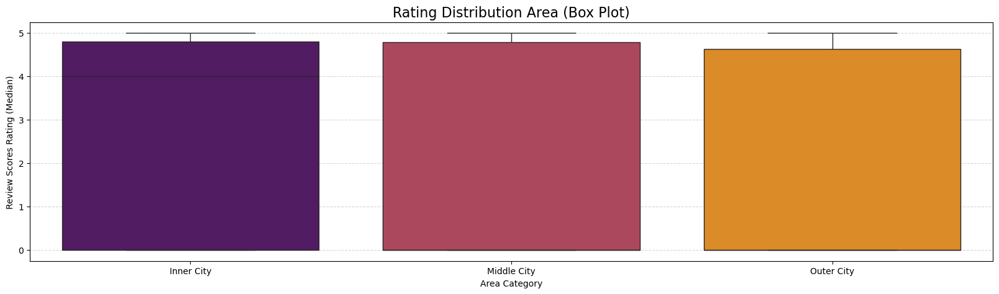

area_category
Inner City     4.0
Middle City    0.0
Outer City     0.0
Name: review_scores_rating, dtype: float64


In [61]:
airbnb_rating_by_area = airbnb.groupby('area_category')['review_scores_rating'].median().sort_values(ascending=False)

plt.figure(figsize=(20, 5))
sns.boxplot(data=airbnb,
            x='area_category',
            y='review_scores_rating',
            palette='inferno',
            order=airbnb_rating_by_area.index)
plt.title('Rating Distribution Area (Box Plot)', fontsize=16)
plt.ylabel('Review Scores Rating (Median)')
plt.xlabel('Area Category')
plt.grid(True, axis='y', linestyle='--', alpha=0.5)
plt.show()
print(airbnb_rating_by_area)

Meskipun area pusat kota (inner city) didominasi rating rendah, **median tertinggi tetap dimiliki oleh inner city** karena tingginya konsentrasi properti di wilayah tersebut.

**Box plot sebaran `price` berdasarkan `area_category`**

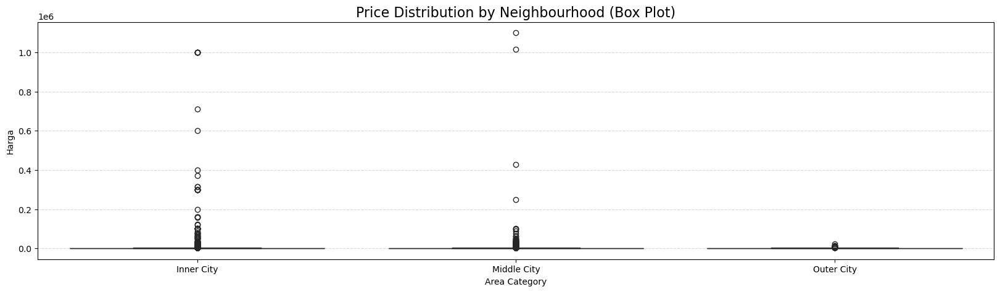

In [64]:
airbnb_price_by_area = airbnb.groupby('area_category')['price'].median().sort_values(ascending=False)

plt.figure(figsize=(20, 5))
sns.boxplot(data=airbnb,
            x='area_category',
            y='price',
            palette='inferno',
            order=airbnb_price_by_area.index)
plt.title('Price Distribution by Neighbourhood (Box Plot)', fontsize=16)
plt.ylabel('Harga')
plt.xlabel('Area Category')
plt.grid(True, axis='y', linestyle='--', alpha=0.5)
plt.show()

**Terdapat perbedaan harga signifikan antara Inner/Middle City dan Outer City dengan selisih sekitar 500-550 satuan**, sementara Inner dan Middle City memiliki harga berdekatan dengan selisih hanya 14 satuan; semua area menunjukkan outlier, dengan Middle City memiliki outlier ekstrem, diikuti Inner City dengan beberapa outlier signifikan namun tidak setinggi Middle City.

### **2. ⁠Perbandingan Rating dan Host Response Rate**

**Boxplot sebaran `review_scores_rating` berdasarkan `host_response_rate`**

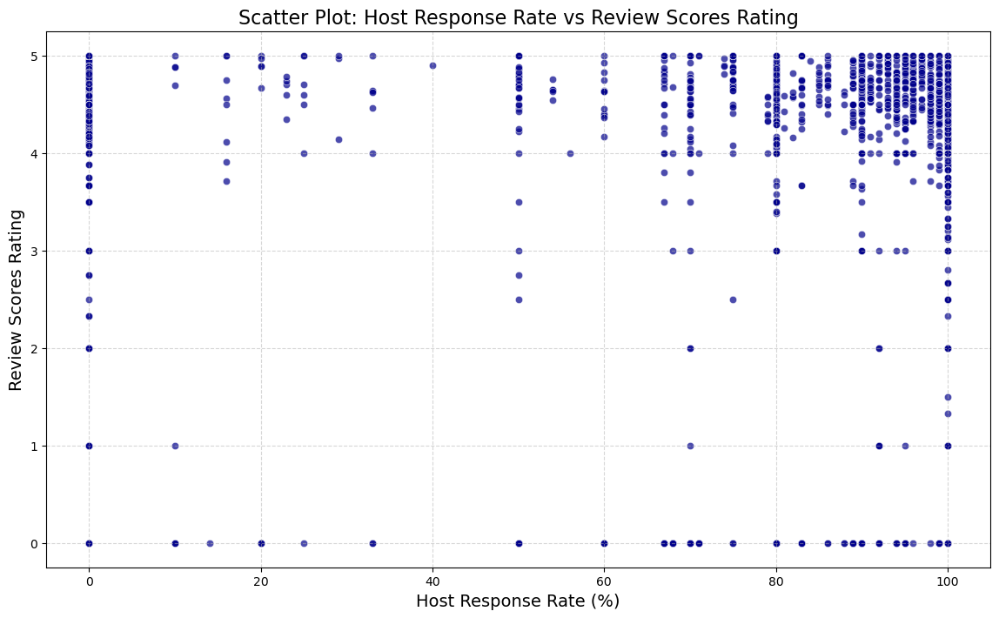

In [67]:
plt.figure(figsize=(14, 8))
sns.scatterplot(
    data=airbnb,
    x='host_response_rate',
    y='review_scores_rating',
    alpha=0.7,
    color='darkblue')
plt.title('Scatter Plot: Host Response Rate vs Review Scores Rating', fontsize=16)
plt.xlabel('Host Response Rate (%)', fontsize=14)
plt.ylabel('Review Scores Rating', fontsize=14)
plt.grid(True, linestyle='--', alpha=0.5)
plt.show()

Terlihat data yang menumpuk pada rentang review 4-5 pada tingkat **response rate** 80-100%. Ini dapat mengindikasikan bahwa **host dengan respons rate tinggi** cenderung mendapatkan **rating yang lebih baik** dari tamu mereka. 

**Boxplot sebaran `review_scores_rating` berdasarkan `host_response_rate` yang dikategorikan**

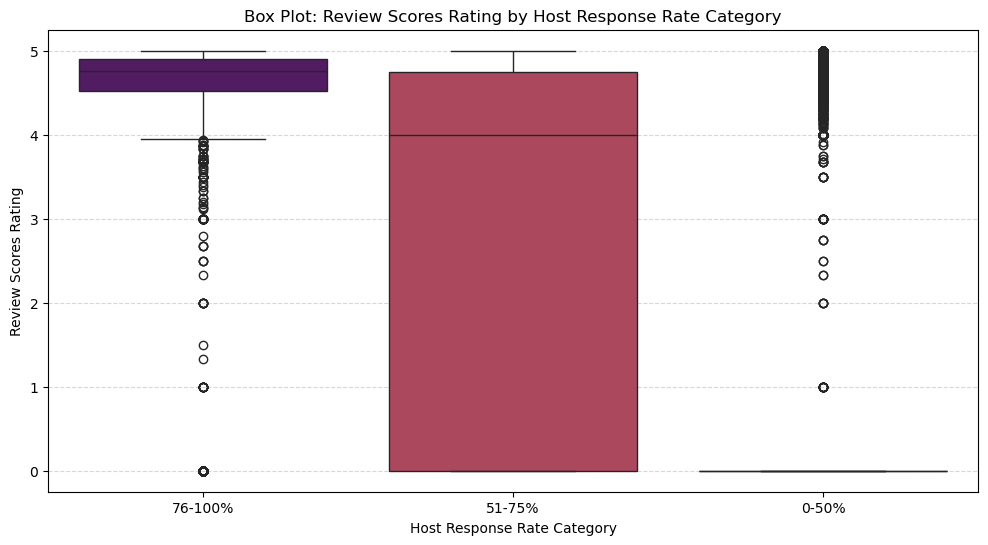

In [70]:
def categorize_response_rate(rate):
    if rate <= 50:
        return '0-50%'
    elif rate <= 75:
        return '51-75%'
    else:
        return '76-100%'

airbnb['response_rate_category'] = airbnb['host_response_rate'].apply(categorize_response_rate)
median_rating = airbnb.groupby('response_rate_category')['review_scores_rating'].median().sort_values(ascending=False)

plt.figure(figsize=(12, 6))
sns.boxplot(data=airbnb, x='response_rate_category', y='review_scores_rating', palette='inferno', 
            order=median_rating.index) 
plt.title('Box Plot: Review Scores Rating by Host Response Rate Category')
plt.xlabel('Host Response Rate Category')
plt.ylabel('Review Scores Rating')
plt.grid(True, axis='y', linestyle='--', alpha=0.5)
plt.show()

Tingkat respons host memang memiliki pengaruh terhadap skor ulasan, namun pengaruh tersebut tidak bersifat linier dan tunggal. Terdapat faktor lain yang mempengaruhi respons host yang nantinya akan dianalisis.

### **3. ⁠⁠Analisis Harga dan Tingkat Hunian**

**Hubungan antara rentang harga `price`dengan ketersediaan properti dalam setahun `availability_365`**

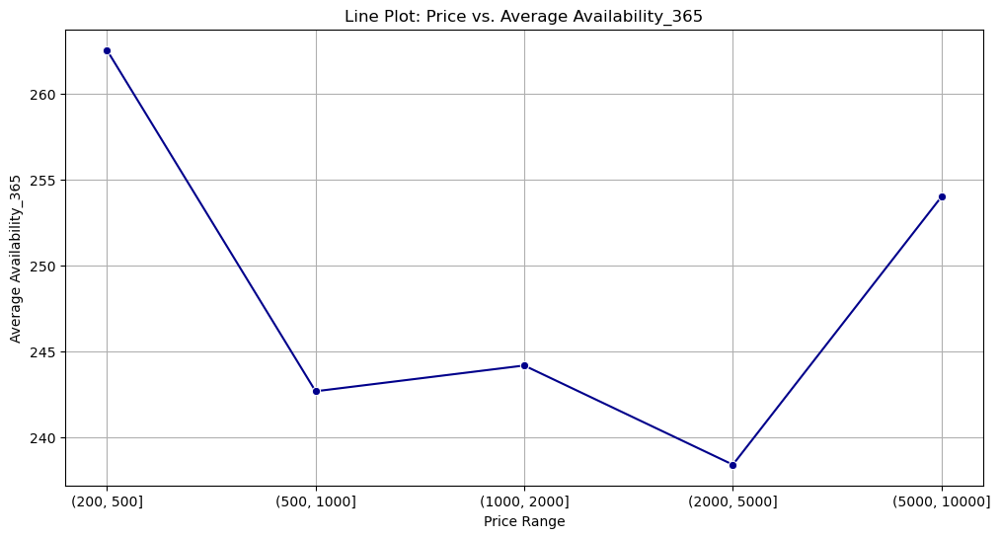

In [73]:
price_bins = pd.cut(airbnb['price'], bins=[0, 50, 100, 200, 500, 1000, 2000, 5000, 10000])
price_availability = airbnb.groupby(price_bins)['availability_365'].mean()

plt.figure(figsize=(12, 6))
sns.lineplot(x=price_availability.index.astype(str), y=price_availability.values, marker='o', color='darkblue')
plt.title('Line Plot: Price vs. Average Availability_365')
plt.xlabel('Price Range')
plt.ylabel('Average Availability_365')
plt.grid(True)
plt.show()

- Properti dengan harga di rentang terendah (200-500) memiliki tingkat ketersediaan yang paling tinggi. Ini mengindikasikan bahwa properti dengan harga terjangkau lebih sering tersedia.
- Properti dengan harga di rentang tertinggi (5000-10000) juga memiliki tingkat ketersediaan yang cukup tinggi. Ini karena properti dengan harga sangat tinggi ditujukan untuk pasar tertentu (misalnya, wisatawan kelas atas).
- Pada rentang harga menengah (500-2000), tingkat ketersediaan cenderung lebih rendah dibandingkan dengan rentang harga ekstrem. Ini karena persaingan yang lebih ketat di segmen pasar ini, sehingga properti dengan harga menengah cenderung lebih cepat terisi.

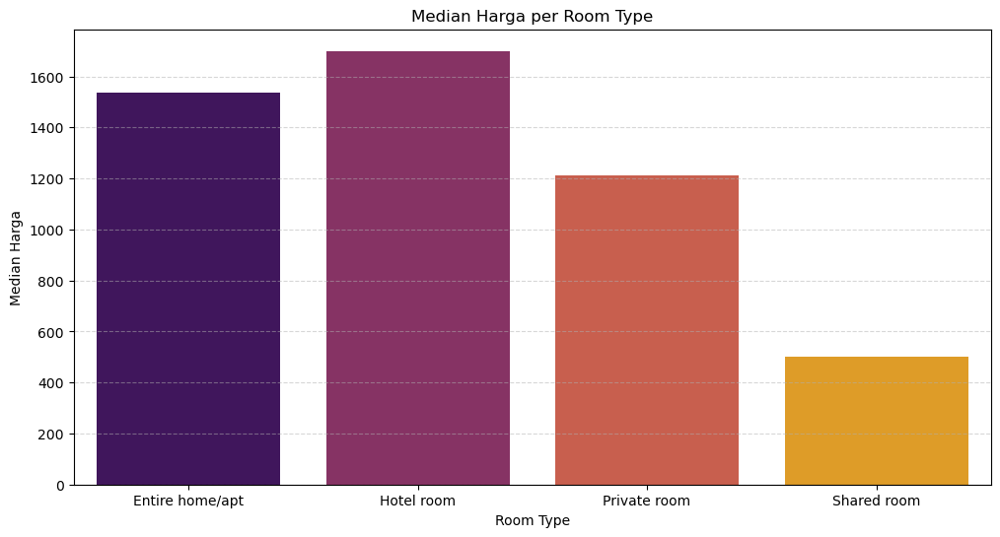

In [75]:
median_price_per_room_type = airbnb.groupby('room_type')['price'].median().reset_index()

plt.figure(figsize=(12, 6))
sns.barplot(x='room_type', y='price', data=median_price_per_room_type, palette='inferno')
plt.title('Median Harga per Room Type')
plt.xlabel('Room Type')
plt.ylabel('Median Harga')
plt.grid(True, axis='y', linestyle='--', alpha=0.5)
plt.show()

## **Analysis**

Untuk analisis yang lebih mendalam terkait pernyataan masalah silakan merujuk pada file berikut untuk kelanjutan analisis secara mendetail. Bagian selanjutnya akan membahas pengujian statistik, visualisasi yang lebih spesifik, serta penggalian pola atau tren yang mungkin tersembunyi, serta saran dan rekomendasi.